## Unveiling Urban Road Challenges - NYC Pothole Prediction
This project focuses on predicting NYC potholes location from the historical data based on zip_codes and treating it as a classification problem. 
The objective of this project is to improve the process of repairing potholes and provide authorities with timely insights into areas where potholes may pose significant challenges.

### Wokrflow
1.  Load Data
2.  Describe Data
3.  Data Cleaning (checking nulls, duplicates)
4.  Perform Basic Analysis
5.  Present and Plot the insights
6.  Feature Engineering
7.  Statistical Analysis
8.  Check for Class Imbalance
9.  Initial Modelling
10. Advance Modelling (PCA, GridSearchCV, Hyperparameter Tuning, Data Scaling)
11. Discuss the best model, its assumptions and errors

In [111]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import re
import seaborn as sns


# import modules
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

import warnings
warnings.filterwarnings('ignore')

#### Load and Describe Data

In [112]:
df = pd.read_csv("../Data/Street_Pothole_Work_Orders_-_Closed__Dataset_.csv") #importing dataset
df.head(10)

,the_geom,DefNum,InitBy,HouseNum,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,SpecLoc,Boro,Source,RptDate,RptClosed,Shape_Leng
0,MULTILINESTRING ((-73.88643460204372 40.630776...,DB2004041154,YRD,NaN,373480377030377030,ROCKAWAY PY,ROCKAWAY PARKWAY,BELT PARKWAY,BELT PARKWAY,NaN,B,YRD,02/08/2004,01/27/2023,557.690465
1,MULTILINESTRING ((-73.94380842208851 40.584992...,DB2004287021,CSC,NaN,318630377030377030,BEDFORD AV,BEDFORD AVENUE,BELT PARKWAY,BELT PARKWAY,SB ON BEDFORD_UNDERNEATH OVERPASS,B,CTZ,10/13/2004,02/14/2013,109.124234
2,MULTILINESTRING ((-73.98570910180842 40.641185...,DB2006085009,CSC,NaN,306380308480308530,13 AV,13 AVENUE,38 STREET,39 STREET,I/F/O B16 BUS STOP,B,CTZ,03/26/2006,10/11/2014,260.495098
3,MULTILINESTRING ((-73.93487210852416 40.679593...,DB2007166005,CSC,1688,342730355530375430,FULTON ST,FULTON STREET,LEWIS AVENUE,SCHENECTADY AVENUE,POTHOLE NEAR CURB I/F/O ADDRESS,B,CTZ,06/15/2007,01/14/2011,549.255973
4,MULTILINESTRING ((-73.97793940872546 40.689806...,DB2009352004,CSC,45,380030331530342730,ST FELIX ST,ST FELIX STREET,DEKALB AVENUE,FULTON STREET,"4"" DEEP",B,CTZ,12/18/2009,01/06/2010,836.436669
5,MULTILINESTRING ((-73.97501506812618 40.640761...,DB2009362038,CSC,514,313830335030367730,AV C,AVENUE C,EAST 5 STREET,OCEAN PARKWAY,ONE POTHOLE I/F/O DRIVE WAY RIGHT OFF THE CURB,B,CTZ,12/28/2009,01/04/2010,385.456668
6,MULTILINESTRING ((-73.92232548215823 40.586294...,DB2009362066,CSC,NaN,342890356960375990,GAIN CT,GAIN COURT,LOIS AVENUE,SEBA AVENUE,CLOSER TO SEBA AVE,B,CTZ,12/28/2009,01/05/2010,529.261511
7,MULTILINESTRING ((-73.96802285162667 40.624450...,DB2009363041,CSC,808,314080335130335180,AV J,AVENUE J,EAST 8 STREET,EAST 9 STREET,IN FRONT OF ADDRESS NEAR BUS STOP,B,CTZ,12/29/2009,01/04/2010,259.706337
8,MULTILINESTRING ((-73.9080474319009 40.6954161...,DB2009363045,CSC,1402,347030352130394730,HANCOCK ST,HANCOCK STREET,IRVING AVENUE,WYCKOFF AVENUE,2 POTHOLES IN FRONT OF 1402 HANCOCK ST,B,CTZ,12/29/2009,01/10/2010,708.233651
9,MULTILINESTRING ((-73.95291388704382 40.706700...,DB2009364034,CSC,NaN,323230349430364630,BDWY,BROADWAY,HEWES STREET,NEW MONTROSE AVENUE,SEVERAL ON STREET,B,CTZ,12/30/2009,01/10/2010,304.584886


In [113]:
df.shape

(360730, 15)

In [114]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 360730 entries, 0 to 360729
Data columns (total 15 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   the_geom    360730 non-null  object 
 1   DefNum      360730 non-null  object 
 2   InitBy      360730 non-null  object 
 3   HouseNum    236000 non-null  object 
 4   OFT         360730 non-null  int64  
 5   OnFaceName  360067 non-null  object 
 6   OnPrimName  360653 non-null  object 
 7   FrmPrimNam  360700 non-null  object 
 8   ToPrimName  360624 non-null  object 
 9   SpecLoc     120304 non-null  object 
 10  Boro        360730 non-null  object 
 11  Source      360730 non-null  object 
 12  RptDate     360730 non-null  object 
 13  RptClosed   360730 non-null  object 
 14  Shape_Leng  360730 non-null  float64
dtypes: float64(1), int64(1), object(13)
memory usage: 41.3+ MB


We have 360730 rows and 15 columns in this data. Out of 15 Features, we have 13 objects, 1 Float and 1 Int.

## Data Cleaning

In [115]:
# checking nulls in the dataset

total_null_count = df.isnull().sum()
print(total_null_count)

the_geom           0
DefNum             0
InitBy             0
HouseNum      124730
OFT                0
OnFaceName       663
OnPrimName        77
FrmPrimNam        30
ToPrimName       106
SpecLoc       240426
Boro               0
Source             0
RptDate            0
RptClosed          0
Shape_Leng         0
dtype: int64


We have a large number of nulls in these columns "House_num", "specific" , "OnFaceName", "ToPrimName" location. The first approach would be to fill the missing data as we have large nuumber of nulls we can't actually replace or impute the missing values from other columns.
The approach we'll be taking is to feature engineer the required data from "the_geom" column, we'll reverse the longitudes and latitudes to extract the address for every location.
I am dropping the columns "House_Num" and "SpecLoc" as we won't be needing them.

In [116]:
df = df.drop(['HouseNum', 'SpecLoc'], axis=1) 

The Data is starting from year 2004 whereas there are only 1 report per year for potholes between year 2004 and 2008. There are only 30 reports for year 2009. So I am filtering the data and starting from year 2010 to remove the outliers and to have real-time insights

In [117]:
# convert datetime object to datetime data type
df['RptDate'] = df['RptDate'].astype('datetime64[ns]')  
df['RptClosed'] = df['RptClosed'].astype('datetime64[ns]')

date_threshold = pd.to_datetime('2009-12-31')

df = df[df['RptDate'] > date_threshold]

Resetting the index as it will be difficult to interpret the data without a numeric index, we already have "DefNum" but it is hard to interpret easily as it have string syntax

In [118]:
df['index'] = range(0, len(df))

### Feature Engineering

We have a feature of longtitudes and latitudes named as "the_geom", I'll feature engineer zip_codes and it will be our target variable.
For that I am first extracting the longitudes and latitudes from the_geom column using regex.
I am looping through the "the_geom" column and selecting the first pair of longitudes and latitudes in each row.

In [119]:
pattern = r'(-?\d+\.\d+)\s(-?\d+\.\d+)' #regex for extracting longtitude and latitude from the "the_geom" string

# Initialize empty lists to store longitude and latitude string
longitudes = []
latitudes = []

# Loop through each string in the list
for coordinates_string in df['the_geom']:
    # Find all matches of latitude and longitude using regular expression
    matches = re.findall(pattern, coordinates_string)
    # Extract the first pair of coordinates
    if matches:
        lon, lat = matches[0]
        longitudes.append(float(lon))
        latitudes.append(float(lat))

# Print the extracted coordinates
print("First pair of longitude and latitude:", longitudes[0] , latitudes[0])

First pair of longitude and latitude: -73.92993757815543 40.59714681302245


In [120]:
df['lon'] = longitudes
df['lat'] = latitudes

Then I am using the library "Geopy" and reversing the longitudes and latitudes to get the address and zip_codes. The main challenge here was the computational limitations. we have 360,000 rows and for every pair of longitude and latitude, Geopy is making an HTTP get API call which was taking a long time to return our desired output.
To resolve that issue, I am using DOCKER on my local machine to improve the computation times. I have set up a "NominAtim" container for NYC geofabrik data. The command to create a container in docker is below.

"docker run -it   -e PBF_URL=https://download.geofabrik.de/north-america/us/new-york-latest.osm.pbf \
       -p 8080:8080   \
       --name nominatim2  mediagis/nominatim:4.4"

I have intentionally commented the code for geopy, as it will take a long time even on local machine, but a lot better than HTTP get request.
I am recreating a new dataset with our original features updated with zip_codes and street names (if we want to predict the street names in future using NLP).

In [121]:
# from geopy.geocoders import Nominatim

# def get_address(latitude, longitude):

#     nominatim_url = '//localhost:8080/'

#     geolocator = Nominatim(user_agent="NYC_Potholes", domain = nominatim_url, scheme = 'http')
#     location = geolocator.reverse((str(latitude), str(longitude)), exactly_one=True)
#     # Extract zip code if available
#     zip_code = location.raw['address'].get('postcode')
    
#     return zip_code

# zip_codes = []

# # Extract address information for each pair of coordinates
# for lat, lon in zip(latitudes, longitudes):
#     zip_code, building_number, street_name, neighbour_hood = get_address(lat, lon)
#     zip_codes.append(zip_code)

In [122]:
# df[zip_code] = zip_codes
# df[street_name] = street_names
# df.to_csv('updated_df')

Importing the new dataset with new features (zip_codes, street_names) extracted Via longitudes and latitudes.

In [123]:
updated_df = pd.read_csv('../Data/updated_df')
updated_df.head()

,Unnamed: 0,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,Boro,...,RptDate,RptClosed,Shape_Leng,index,lon,lat,zip_code,building_number,street_name,neighbour_hood
0,11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,B,...,2010-01-02,2010-01-05,82.707368,0,-73.929938,40.597147,11229,3206,Avenue W,Gerritsen Beach
1,12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,B,...,2010-01-02,2010-01-05,426.877885,1,-73.939334,40.622726,11210,1351,East 37th Street,NaN
2,13,MULTILINESTRING ((-73.96733404030275 40.581517...,DB2010003002,CSC,392230367730390730,W AV,WEST AVENUE,OCEAN PARKWAY,WEST 5 STREET,B,...,2010-01-03,2010-01-05,1071.289104,2,-73.967334,40.581518,11235,NaN,Ocean Parkway,West Brighton
3,14,MULTILINESTRING ((-73.95866587485429 40.712797...,DB2010003004,CSC,373650378130378230,ROEBLING ST,ROEBLING STREET,SOUTH 1 STREET,SOUTH 2 STREET,B,...,2010-01-03,2010-01-08,254.973102,3,-73.958666,40.712797,11211,227,South 1st Street,NaN
4,15,MULTILINESTRING ((-73.98873129769669 40.593001...,DB2010003005,CSC,307730315780347730,26 AV,26 AVENUE,BATH AVENUE,HARWAY AVENUE,B,...,2010-01-03,2010-01-05,729.958297,4,-73.988731,40.593002,11214,8782,26th Avenue,NaN


I want to check the seasonal patterns for the occurence of the potholes. For that I am feature engineering a "month" column from "RptDate" column. First I have to convert it itno pandas datetime format.
Then I am calculating the number of days it took to fix a pothole.

In [124]:
updated_df['RptDate'] = updated_df['RptDate'].astype('datetime64[ns]') 
updated_df['RptClosed'] = updated_df['RptClosed'].astype('datetime64[ns]')

updated_df['month'] = updated_df['RptDate'].dt.month_name()

## Gathering Inisghts

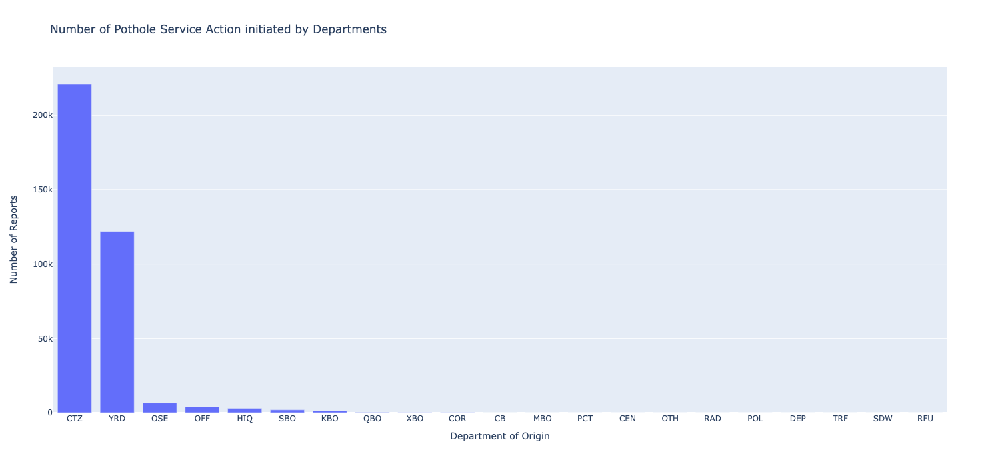

In [125]:
# Plotting the number of reports init

value_counts_Source = updated_df['Source'].value_counts().reset_index() # storing count of values in a variable of "InitBy" column
value_counts_Source.columns = ['Department of Origin', 'Number of Reports'] # accessing columns of the dataframe and assigning value and counts column

fig = px.bar(value_counts_Source, x='Department of Origin', y='Number of Reports', title='Number of Pothole Service Action initiated by Departments')
fig.update_layout(height=700)

# Show the plot
fig.show()

The Citizens and Yard department has contributed most, about 90% of the potholes reports. 

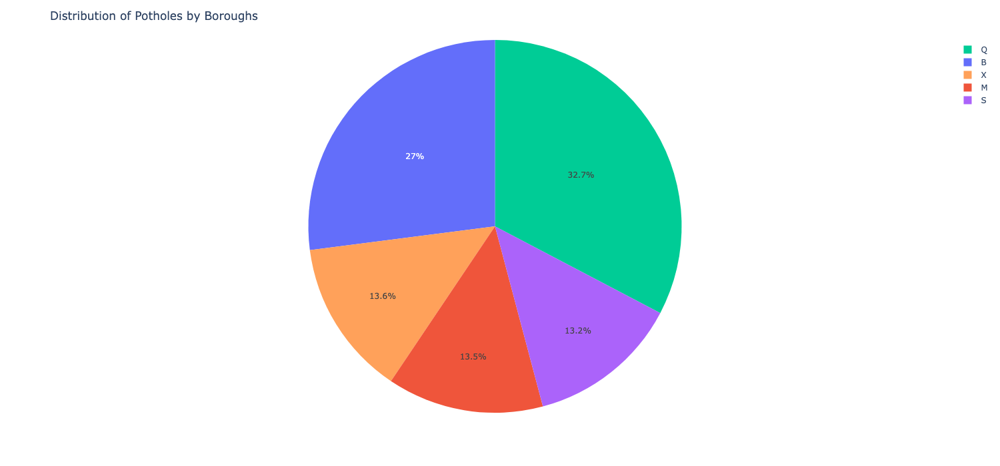

In [126]:
# Plot distribution of Number of Potholes by Boroughs of NYC

fig = px.pie(updated_df, 
             values=updated_df['index'].value_counts().values, 
             names='Boro', color='Boro')
fig.update_layout(title_text='Distribution of Potholes by Boroughs', height=700, width=700)

fig.show()

We can see that the most number of potholes occurences are in Queens and then Brooklyn. We can assume that number of potholes are dependent on the area, population and road networks of Boroughs.

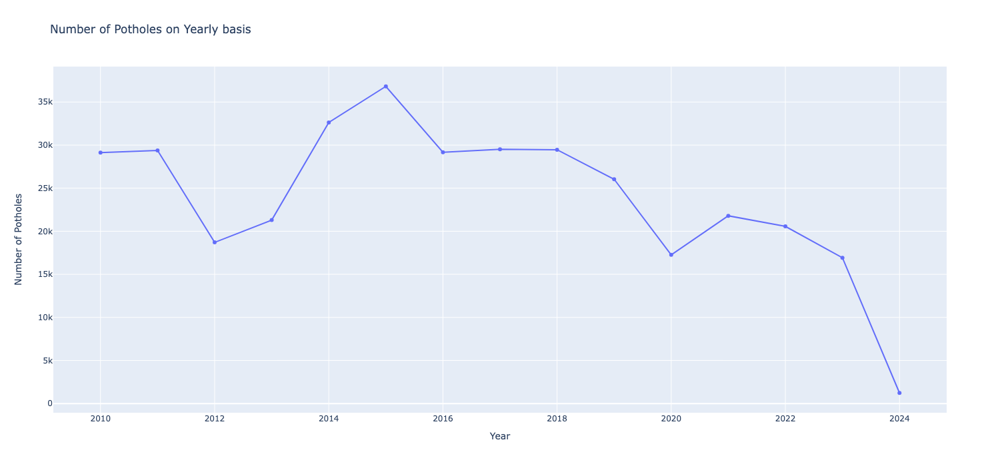

In [127]:
# Plot number of potholes on yearly basis
updated_df['year'] = pd.to_datetime(updated_df['RptDate'], format='%Y') #extracting year

# Group by year and count potholes
potholes_by_year = updated_df.groupby(updated_df['year'].dt.year).size().reset_index(name='potholes_count')

# Create a Plotly line plot
fig = px.line(potholes_by_year, x='year', y='potholes_count', markers=True, title='Number of Potholes on Yearly basis')
fig.update_layout(xaxis_title='Year', yaxis_title='Number of Potholes')
fig.update_layout(height=700)

# Show the plot
fig.show()

In [128]:
potholes_by_year.mean()

year               2017.000000
potholes_count    23992.933333
dtype: float64

The highest number of potholes recorded in NYC in a calendar year was 2015 with slightly over 36K potholes. Overall the yearly average is 24032 potholes per year.

In [129]:
# Days took to fix the pothole
date_diff = updated_df['RptClosed'] - updated_df['RptDate']
total_seconds = date_diff.apply(lambda x: int(x.total_seconds()))
updated_df['Hours_to_fix'] = total_seconds/3600 # creating column with number of hours it took to fix a pothole

On avegrage it took the relative department 4 days and half to fix a pothole. However, there are few outliers as well which took months to fix a pothole, probably it depends on the size of pothole and complexity involved.

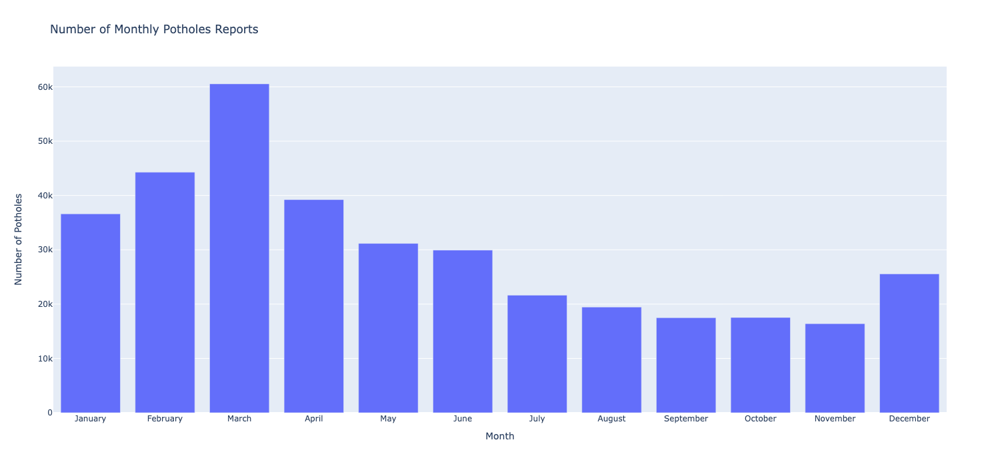

In [130]:
# months with most potholes

# Group by month and calculate the sum of potholes_count
monthly_potholes = updated_df.groupby('month')['index'].count().reset_index()

# Create a Plotly bar chart
fig = px.bar(monthly_potholes, x='month', y='index', title='Number of Monthly Potholes Reports')

fig.update_layout(xaxis_title='Month', yaxis_title='Number of Potholes', height=700)

#plotly is not preserving monthly order so I have to pass the parameters to adjust the monthly order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
fig.update_xaxes(categoryorder='array', categoryarray=month_order)


# Show the plot
fig.show()

The trend to note here is that the pothole numbers are maximum in the spring season which helped me to unveil an interesting fact that If the water freezes and thaws over and over, the pavement will weaken and continue cracking. 

In [131]:
updated_df['zip_code'].nunique()

228

In [132]:
updated_df.head()

total_null_count = updated_df.isnull().sum()
print(total_null_count)

Unnamed: 0              0
the_geom                0
DefNum                  0
InitBy                  0
OFT                     0
OnFaceName              0
OnPrimName              0
FrmPrimNam              0
ToPrimName              0
Boro                    0
Source                  0
RptDate                 0
RptClosed               0
Shape_Leng              0
index                   0
lon                     0
lat                     0
zip_code                0
building_number     85355
street_name          1428
neighbour_hood     111046
month                   0
year                    0
Hours_to_fix            0
dtype: int64


There are 228 number of unique zip codes in the dataset and some of them have more representation in the data. we'll further check if some zip codes have more population or a bigger area.

### One hot encoding

In [133]:
Boro_value_counts = df['Boro'].value_counts()
source_value_counts = df['Source'].value_counts()
initBy_value_counts = df['InitBy'].value_counts()

print(Boro_value_counts)
print('-' * 50)  # Print a line separator
print(source_value_counts)
print('-' * 50)  # Print a line separator
print(initBy_value_counts)

Q    118096
B     97365
X     48972
M     48781
S     47471
Name: Boro, dtype: int64
--------------------------------------------------
CTZ    221543
YRD    122213
OSE      6470
OFF      3884
HIQ      2936
SBO      1861
KBO      1181
QBO       246
XBO       117
COR        78
CB         51
MBO        35
PCT        28
CEN        20
OTH         8
RAD         4
POL         4
DEP         2
TRF         2
SDW         1
RFU         1
Name: Source, dtype: int64
--------------------------------------------------
YRD    132346
CSC    103318
SPH     66550
ONF     45592
OFF      5217
SBO      4520
HIQ      1264
DOT      1210
QBO       579
XBO        36
MBO        30
KBO        19
CIU         3
COM         1
Name: InitBy, dtype: int64


For the statistical analysis, modelling we need to have our dataset number types. For that I am mapping and converting our string type values to numbers. 

Boro : There are 5 boros in NYC and I am mapping them with numbers.

Source : There are 12 unique values in the source column, I am labeling the top 5 as they are contributing the most and grouping rest as 6

InitBy : There are 14 unique values in the Initby column, I am labeling the top 6 as they are contributing the most and grouping rest as 7

Month : Mapping month name as Numbers.

In [134]:
borough_map = {'B': 1, 'X': 2, 'Q': 3, 'M': 4, 'S': 5}

# Map the borough column to integers
updated_df['Boro_num'] = updated_df['Boro'].map(borough_map)

In [135]:
def map_source_values(source):  # mapping source values
    switch = {
        'CTZ': 1,
        'YRD': 2,
        'OSE': 3,
        'OFF': 4,
        'HIQ': 5
    }
    return switch.get(source, 6)  # Default value is 6 if code is not found in the switch dictionary

# Apply the function to map values
updated_df['Source_num'] = updated_df['Source'].apply(map_source_values)

def map_initby_values(initby):  # mapping InitBy values
    switch = {
        'YRD': 1,
        'CSC': 2,
        'SPH': 3,
        'ONF': 4,
        'OFF': 5,
        'SBO': 6
    }
    return switch.get(initby, 7)  # Default value is 5 if code is not found in the switch dictionary

# Apply the function to map values
updated_df['InitBy_num'] = updated_df['InitBy'].apply(map_initby_values)

In [136]:
def map_months_values(month_name):  # mapping month values
    switch = {
        'January': 1,
        'February': 2,
        'March': 3,
        'April': 4,
        'May': 5,
        'June': 6,
        'July': 7,
        'August': 8,
        'September': 9,
        'October': 10,
        'November': 11,
        'December': 12
        
    }
    return switch.get(month_name, 0)

# Apply the function to map values
updated_df['month_num'] = updated_df['month'].apply(map_months_values)

In [137]:
updated_df = updated_df.drop(columns=['Unnamed: 0', 'the_geom', 'DefNum', 'InitBy', 'OFT', 'OnFaceName', 'FrmPrimNam', 'ToPrimName' , 'OnPrimName',  'Source', 'Boro', 'index', 'RptDate', 'RptClosed' , 'month' ,'year', 'neighbour_hood','building_number'])

Preparing the data for analysis and modelling. Dropping the columns which have already been converted to dummies and labels. Also we have feature engineered the locations as zip codes and street names so I am dropping all columns related to locations as they have large nummber of nulls and I can't impute or replace those. Dropping RptDate and RptClosed as I have feature engineered the month column for seasonality.

In [138]:
updated_df.head(10)

,Shape_Leng,lon,lat,zip_code,street_name,Hours_to_fix,Boro_num,Source_num,InitBy_num,month_num
0,82.707368,-73.929938,40.597147,11229,Avenue W,72.0,1,1,2,1
1,426.877885,-73.939334,40.622726,11210,East 37th Street,72.0,1,1,2,1
2,1071.289104,-73.967334,40.581518,11235,Ocean Parkway,48.0,1,1,2,1
3,254.973102,-73.958666,40.712797,11211,South 1st Street,120.0,1,1,2,1
4,729.958297,-73.988731,40.593002,11214,26th Avenue,48.0,1,1,2,1
5,830.345995,-73.940394,40.602895,11229,Brown Street,96.0,1,1,2,1
6,259.482571,-74.035437,40.619956,11209,Ridge Boulevard,24.0,1,1,2,1
7,293.369578,-73.993348,40.664955,11215,17th Street,72.0,1,1,2,1
8,693.982730,-74.017457,40.644848,11220,NaN,24.0,1,1,2,1
9,730.378674,-73.939965,40.662233,11203,East New York Avenue,24.0,1,1,2,1


## Statistical Analysis
#### Correlation

In [139]:
updated_df= updated_df.drop([ 'Source_num'], axis=1)

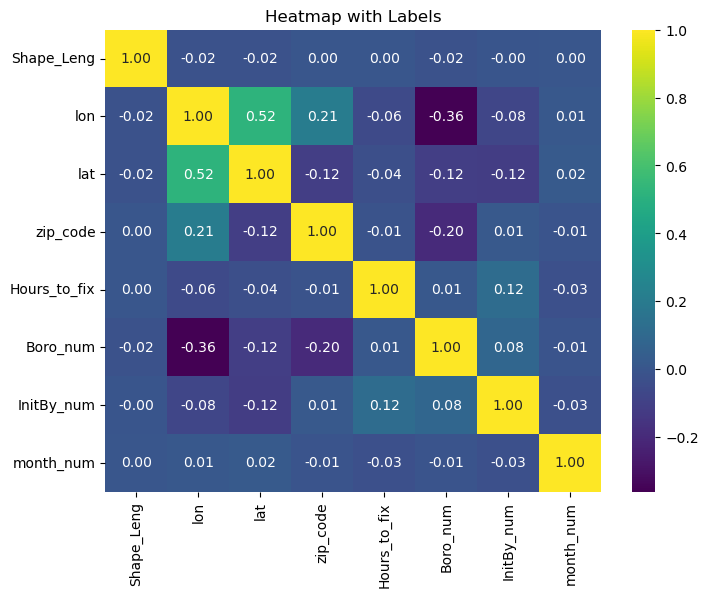

In [140]:
plt.figure(figsize=(8, 6))
sns.heatmap(updated_df.corr(), annot=True, cmap='viridis', fmt='.2f', annot_kws={'size': 10})
plt.title('Heatmap with Labels')
plt.xticks(rotation=90)  
plt.yticks(rotation=0)
plt.show()

Overall there is a trend of negative and zero co-relations between features which is not providing a useful insight to gather the imortance of features for the occurence of potholes. So far latitudes and longitudes have a good correlation with zip code.
Feature name "Shape_Leng" is not actually helping at all. So I am going to drop this feature.

#### PCA analysis

In [141]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(updated_df)

pca = PCA()
principal_components = pca.fit_transform(scaled_features)

explained_variance_ratio = pca.explained_variance_ratio_
print("Explained Variance Ratio:", explained_variance_ratio)

# Step 4: Scree Plot
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o', linestyle='-')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.show()

ValueError: could not convert string to float: 'Avenue W'

The feature with the highest variance is "Shape_Leng" as we have different sizes of potholes. We'll be dropping this feature for modelling as its correlation with other features is literally zero.
Other than that rest of the features are pretty close to each other in terms of co-variance. Which is in my opinion is not that good for modelling as we are predicting a large number of zipcodes and the model is supposed to learn well.

In [ ]:
X = updated_df.drop(['zip_code', 'Shape_Leng'], axis=1)
y = updated_df['zip_code']

#### Baseline Model - Logistic Regression with Accuracy, Precision, Recall and F1-scores

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize features using StandardScaler
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Create and fit the logistic regression model
logistic_model = LogisticRegression()
logistic_model.fit(X_train_scaled, y_train)

# Predict the labels for the test set
y_pred = logistic_model.predict(X_test_scaled)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

print("Test Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

# Hyperparameter tuning
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100], 'penalty': ['l1', 'l2']}
grid_search = GridSearchCV(LogisticRegression(max_iter=1000), param_grid, cv=5)
grid_search.fit(X_train_scaled, y_train)

best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

print("Best Hyperparameters:", best_params)

# Re-fit the model with the best hyperparameters
best_model.fit(X_train_scaled, y_train)

# Predict the labels for the test set using the best model
y_pred_best = best_model.predict(X_test_scaled)

# Calculate evaluation metrics for the best model
accuracy_best = accuracy_score(y_test, y_pred_best)
precision_best = precision_score(y_test, y_pred_best, average='weighted')
recall_best = recall_score(y_test, y_pred_best, average='weighted')
f1_best = f1_score(y_test, y_pred_best, average='weighted')

print("Best Model Test Accuracy:", accuracy_best)
print("Best Model Precision:", precision_best)
print("Best Model Recall:", recall_best)
print("Best Model F1 Score:", f1_best)

#### Evaluation Metrics for baseline model
Accuracy: 
* Out of all the instances in the test dataset, the model predicts the correct zip code for approximately 68% of them.

Precision: 66.3% which means that approximately 66.3% of the instances predicted as positive (belonging to a certain zip code) are indeed correct.

Recall: 68.3%  means that approximately 68.3% of the actual positive instances (belonging to a certain zip code) are correctly identified by the model.

F1 score: 64.9% means that the overall performance of the model is reasonably balanced between precision and recall.



### Testing other common ML algorithms
Let's try some other models which will possibly help us identify the best model for our classification problem.
1. Random Forest
2. Support Vector Machines
3. Neural Networks
4. KNN

To optimize the results, I am only using Standard Scaler for now. This is just a peek into the performance of different models.

In [ ]:
from sklearn.metrics import precision_score, recall_score

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Initialize StandardScaler
scaler = StandardScaler()

# Scale the features
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize models
models = {
    'Random Forest': RandomForestClassifier(),
    'SVM': SVC(),
    'Neural Network': MLPClassifier(),
    'K-Nearest Neighbors': KNeighborsClassifier(),
}

# Fit and evaluate each model
for name, model in models.items():
    # Fit the model
    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    train_accuracy = accuracy_score(y_train, y_train_pred)
    print(f'{name} Train Accuracy: {train_accuracy:.4f}')
    
    # Predict on the test data
    y_pred = model.predict(X_test_scaled)
    test_accuracy = accuracy_score(y_test, y_pred)
    
    # Print the accuracy score
    print(f'{name} Test Accuracy: {test_accuracy:.4f}')

For the basic modelling I have tried multiple models to list-down the models which help us best predict the target(zipcodes). It will also give us a peek into overfitting and underfitting.
I didn't decide to go for PCA or Hyperparameter optimization for the initial modeling phase.
So far the ML algos which are performing well are:

Random Forest: The model is slightly overfitting and it is learning too much from the data. I have to check for data leakage and optimization. Train and test 100% and 92%.

Support Vector Machines: This model is also not overfitting and performing quite good. Train and Test 76%.

Neural Networks: This algorithm has performed best among all with the train and test accuracy of 84%. The model is not overfitting and so far it looks more promising than others.

K-Nearest Neighbors: This model is definitely overfitting with the train accuracy of 83% and test accuracy of 74%.

* So far the short-listed models are Random Forest and Neural Networks. I'll go ahead and try to best optimize these two models with GridSearchCV, PCA and put it into a pipeline.

#### Random Forest Tree with Hyperparameters Tuning, Pipeline and Principal Components Reduction

In [ ]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Define a pipeline with preprocessing steps
pipeline = Pipeline([
    ('scaler', StandardScaler()),   # Feature scaling
    ('pca', PCA()),                 # Dimensionality reduction with PCA
    ('classifier', RandomForestClassifier(random_state=42))  # Random Forest classifier
])

# Define parameter grid for GridSearchCV
param_grid = {
    'classifier__max_depth': [None, 5, 10, 15],
    'classifier__min_samples_split': [2, 5, 10],
}

# Perform GridSearchCV with cross-validation
grid_search = GridSearchCV(pipeline, param_grid=param_grid, scoring='accuracy', cv=5, verbose=2)

grid_search.fit(X_train, y_train)

# Get the best model from GridSearchCV
best_model = grid_search.best_estimator_

# Fit the best model on the training data
best_model.fit(X_train, y_train)

# Predictions
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test) 

# Calculate accuracy
train_accuracy = accuracy_score(y_train, y_train_pred)
test_accuracy = accuracy_score(y_test, y_test_pred)

# Classification report
classification_rep = classification_report(y_test, y_test_pred)

print("Best Model Parameters:", grid_search.best_params_)
print("Train Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("\nClassification Report:\n", classification_rep)

#### Neural Nwtworks with PCA, Pipeline and Hyperparamters

In [ ]:
# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Construct a pipeline with standard scaling, PCA, and neural network classifier
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA()),
    ('clf', MLPClassifier(max_iter=1000))  # You can adjust max_iter as needed
])

# Define hyperparameters grid for GridSearchCV
param_grid = {
    'pca__n_components': [4,5,6],  # Number of principal components
    'clf__activation': ['relu'],  # Activation functions
    'clf__alpha': [0.0001, 0.001, 0.01]  # Regularization parameter
}

# Initialize GridSearchCV
grid_search = GridSearchCV(pipeline, param_grid, cv=5)

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

# Best parameters found by GridSearchCV
print("Best Parameters:", grid_search.best_params_)

# Predict on the training set
train_preds = grid_search.predict(X_train)
# Calculate training accuracy
train_accuracy = accuracy_score(y_train, train_preds)
print("Training Accuracy:", train_accuracy)

# Predict on the test set
test_preds = grid_search.predict(X_test)
# Calculate test accuracy
test_accuracy = accuracy_score(y_test, test_preds)
print("Test Accuracy:", test_accuracy)

Final thoughts, so far I have tried using miltiple machine learning algorithms and shortlisted neural networks and random forest. I also tried multiple hyperparameters with the short-listed models but it was taking forever to compile them. Due to that I was unable to discuss model performance for Neural Networks and Random Forest for now. Next steps would include Advance modelling with the model errors and discussion. 